# scVI data integration of Myeloid compartment

In [1]:
import sys 
import os
from datetime import datetime

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scvi
import hdf5plugin

import matplotlib.pyplot as plt
import seaborn as sns

# Add repo path to sys path (allows to access scripts and metadata from repo)
repo_path = os.path.split(os.getcwd())[0]
sys.path.insert(1, repo_path) 
sys.path.insert(2, '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/scripts')

from scvi_wrapper2 import run_scvi
import torch
torch.cuda.is_available()

%reload_ext autoreload

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [3]:
# Define plot and path dirs
plot_path = os.path.join(repo_path, 'plots')
data_path = os.path.join(repo_path, 'data')
model_path = os.path.join(repo_path, 'models')
general_data_path = '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data'

In [4]:
myeloid_mrkrs_dict = {
    'Early progenitor': ['CD34', 'SPINK2'], # 'MLLT3'
    'Myeloid progenitor': ['PRSS57', 'PRTN3', 'AZU1'],
    'Neutrophil lineage': ['ELANE', 'DEFA4', 'LCN2', 'ORM1'],
    'Monocyte lineage': ['CD52', 'S100A8', 'MS4A6A', 'CD14', 'CXCR4', 'CCR2', 'IL1B'],
    'RBC': ['GYPA', 'GYPB','HBA1', 'HBA2'],
    'panMacrophage':['CD68', 'CD163'],
    'LYVE1 Macrophage': ['LYVE1', 'EGFL7', 'LILRB5'], #'CX3CR1' 
    'SPIC Macrophage': ['SPIC', 'TIMD4'],
    'APOC2 Macrophage': ['APOC2', 'MMP9', 'GPNMB'],
    'cDC1': ['CLEC9A', 'XCR1'],
    'cDC2': ['CLEC10A', 'CD1C'],
    'aDC': ['LAMP3', 'CCR7', 'CD80', 'HLA-DRA', 'CD86'],
    'aDC1':['IDO1', 'CST7', 'IL12B', 'KCNN1'], #'TNFRSF11A', 'ST7',
    'aDC2':['TNFRSF11B', 'CCL17','LYPD3', 'CLEC4G'],#'NEK6', 'CCL22',
    'aDC3':['SELENOM', 'MT2A', 'EYA4', 'SYNPO2'],
    'AIRE DCs': ['TNFRSF11B', 'AIRE'],
    'pDC' :['LILRA4', 'CLEC4C'],
    'Prolif':['MKI67', 'TOP2A']}

myeloid_mrkrs = []
[myeloid_mrkrs.extend(myeloid_mrkrs_dict[key]) for key in myeloid_mrkrs_dict.keys()]

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

## Load data

In [5]:
adata = ad.read_h5ad(f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v2_2layers_300epochs_2025-01-16.zarr')

In [6]:
adata_obs = pd.read_csv(f'{data_path}/objects/thyAgeing_Myeloid_v2_2layers_300epochs_2025-01-16_anno1.csv', index_col = 0)

In [7]:
adata.obs['Myeloid_anno'] = adata_obs.reindex(adata.obs_names)['Myeloid_anno'].copy()

In [8]:
doublets = [i for i in adata.obs['Myeloid_anno'].unique().tolist() if 'doublet' in i]
adata_dbrm = adata[~adata.obs['Myeloid_anno'].isin(doublets),]

In [9]:
adata.shape
adata_dbrm.shape

(19821, 35530)

(14718, 35530)

In [10]:
adata = adata_dbrm.copy()

## Data integration

### remove samples having fewer than 3 cells 

In [11]:
adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()

['THY_81',
 'A67-THY-0-SC-FACS-1_5GEX',
 'THY_57',
 'sample4',
 'sample8',
 'sample10']

In [12]:
samples2remove = adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()

adata_temp = adata.copy()
adata = adata[~adata.obs['sample'].isin(samples2remove),:].copy()
adata_temp.shape
adata.shape

(14718, 35530)

(14706, 35530)

del adata_temp
import gc 
gc.collect()

In [13]:
general_mrkrs = ['PTPRC', 'CD3G', 
               'HOXA9', 
               'HES1', #DN
               'RORC', #DP
               'CCR9',
              'PDCD1', #CD8aa
              'CD8A', 'CD8B', 
              'CD4', 'CD40LG', 
              'CRTAM', 'ANXA1', #memory
             'FOXP3', 'DHRS3', 
               'TRDC', #gama-delta 
              'EOMES', 'KLRD1', # NK cells
              'TNFSF11', # ILC
              'CD19', 'VPREB1', # pre-pro B cells
              'IGHD', 'IGHA1', 'IGHG1', 
              'CLEC9A', 'CLEC10A', 
              'LAMP3', 
             'LILRA4','S100A9', 'C1QA', 'TPSB2', 'ITGA2B', 'GYPA', 
              'PDGFRA', 'COLEC11', 'FBN1', 
              'RGS5', 'CDH5', 
               'LYVE1', 'EPCAM', 'PSMB11', 'DLK2', 'KRT14', 
               'CCL19', 'AIRE', 'KRT1', 'POU2F3',
               'MYOD1', 'NEUROG1']

[i for i in general_mrkrs if i not in adata.var_names]

[]

In [14]:
adata.obs['age_months'] = adata.obs['age_months'].astype(float)

adata.obs[['age_group', 'age_months','donor', 'chemistry_simple', 'sort', 'study']]

,age_group,age_months,donor,chemistry_simple,sort,study
names,,,,,,
TA13072046-ATGTGTGTCTCTAAGG,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-GGGTTGCGTGATGTCT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-TTGTAGGGTACTCTCC,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-TTAGTTCTCTGTCTAT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-CTGTTTAAGTGACTCT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
...,...,...,...,...,...,...
TEC_96-TTTGGAGTCAGGACGA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-ATTTCACCATCCTAAG,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-GTAATCGGTACCGGAA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024


In [ ]:
scvi_run = run_scvi(adata, 
                    # Excluded genes
                    include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
                    exclude_vdjgenes = True, remove_cite = False,
                    # Highly variable gene selection
                    batch_hv="age_group", hvg = 10000, span = 0.5,
                    # scVI 
                    batch_scvi="sample",
                    cat_cov_scvi=["donor", "chemistry_simple", "sex"], 
                    cont_cov_scvi=None, max_epochs=300,
                 #   max_epochs=400, batch_size=2000, # early_stopping = True, early_stopping_patience = 10, early_stopping_min_delta = 10,
                    check_val_every_n_epoch = 1,
                    plan_kwargs = {'lr': 0.0001}, n_layers = 2, n_latent = 30, dispersion = 'gene-batch',
                    # Leiden clustering
                    leiden_clustering = None, col_cell_type = 'taa_l4', 
                    covs = {'doublet_metric': ['scrublet_score', 'predicted_doublet', 'n_genes', 'n_counts'],
                    'age': ['age_group', 'age_months'],
                    'batch_mixing': ['donor', 'chemistry_simple', 'sort', 'study']})

Removed excluded genes
Highly variable genes selected in total (14706, 10000)


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=5` in the `DataLoader` to improve performance.
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=5` in the `DataLoader` to improve performance.


Epoch 28/300:   9%| | 27/300 [00:59<08:26,  1.86s/it, v_num=1, train_loss_step=2.12e+3, t

In [ ]:
# Save adata and scvi model
scvi_embed_version = 'scvi_v2_2024-11-05_myeloidSplit'
scvi_obj_version = f'v3_2layers_300epochs_{datetime.now().strftime("%Y-%m-%d")}'
overwrite = True

#anno_cols = [c for c in scvi_run['data'].obs.columns if '_pred_' in c or '_prop_' in c]
if not os.path.exists(f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr') or overwrite:
#    scvi_run['data'].obs = scvi_run['data'].obs.drop(columns=anno_cols)
    scvi_run['data'].write_h5ad(
        f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr',
        compression=hdf5plugin.FILTERS["zstd"],
        compression_opts=hdf5plugin.Zstd(clevel=5).filter_options,
    )
    scvi_run['vae'].save(f'{model_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}', save_anndata=True, overwrite=True)
else:
    print('File already exists')



In [31]:
adata = scvi_run['data'].copy()

In [6]:
adata = ad.read_h5ad(f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-01-24.zarr')

vae = scvi.model.SCVI.load(f'{model_path}/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-01-24')

INFO     File                                                                                                      
         /nfs/team205/vk8/projects/thymus_ageing_atlas/Myeloid_compartment/models/thyAgeing_scvi_v2_2024-11-05_myel
         oidSplit_v3_2layers_300epochs_2025-01-24/model.pt already downloaded                                      


/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/scvi/data/fields/_dataframe_field.py:221: UserWarning: Category 35 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/scvi/data/fields/_arraylike_field.py:407: UserWarning: Category 16 in adata.obs['donor'] has fewer than 3 cells. Models may not train properly.
  mapping = _make_column_categorical(df, key, key, categorical_dtype=categorical_dtype)


In [13]:
adata.X.data

array([6, 5, 2, ..., 5, 1, 3], dtype=uint32)

In [14]:
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)

In [15]:
import celltypist
model_taa_l1 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l1_2024-12-10.pkl')

predictions_l1 = celltypist.annotate(adata, model=model_taa_l1, majority_voting = True)
predictions_l1.to_adata(prefix='ctypist_taa_l1')

model_taa_l4 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l4_2024-12-10.pkl')

predictions_l4 = celltypist.annotate(adata, model=model_taa_l4, majority_voting = True)
predictions_l4.to_adata(prefix='ctypist_taa_l4')

🔬 Input data has 14718 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 3962 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 14718 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'Myeloid_anno', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l1conf_score'
    var: 'gene_ids', 'gene_name', 'n_counts', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'age_group_colors', 

🔬 Input data has 14718 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6783 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 14718 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'Myeloid_anno', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l1conf_score', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_

In [16]:
sc.pl.umap(adata, color = myeloid_mrkrs)

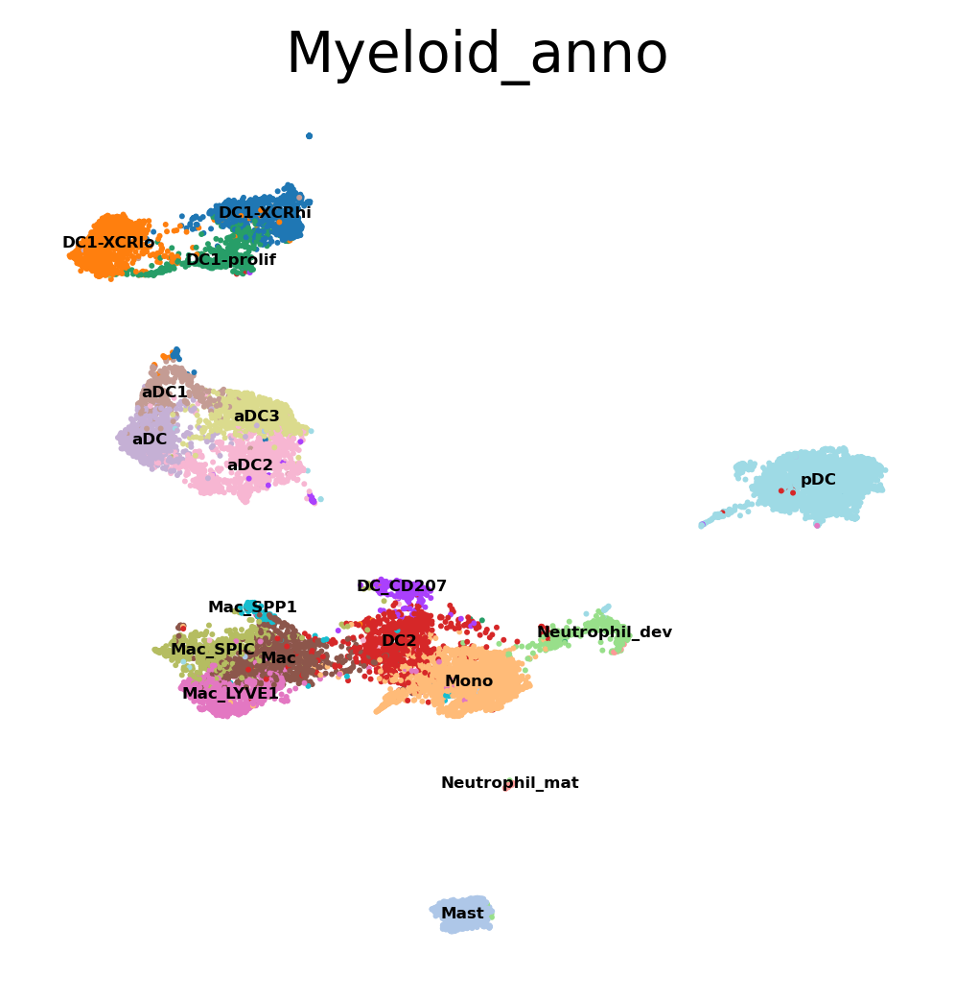

In [18]:
sc.pl.umap(adata, color = 'Myeloid_anno', legend_loc = 'on data', legend_fontsize = 4, frameon = False)

In [76]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

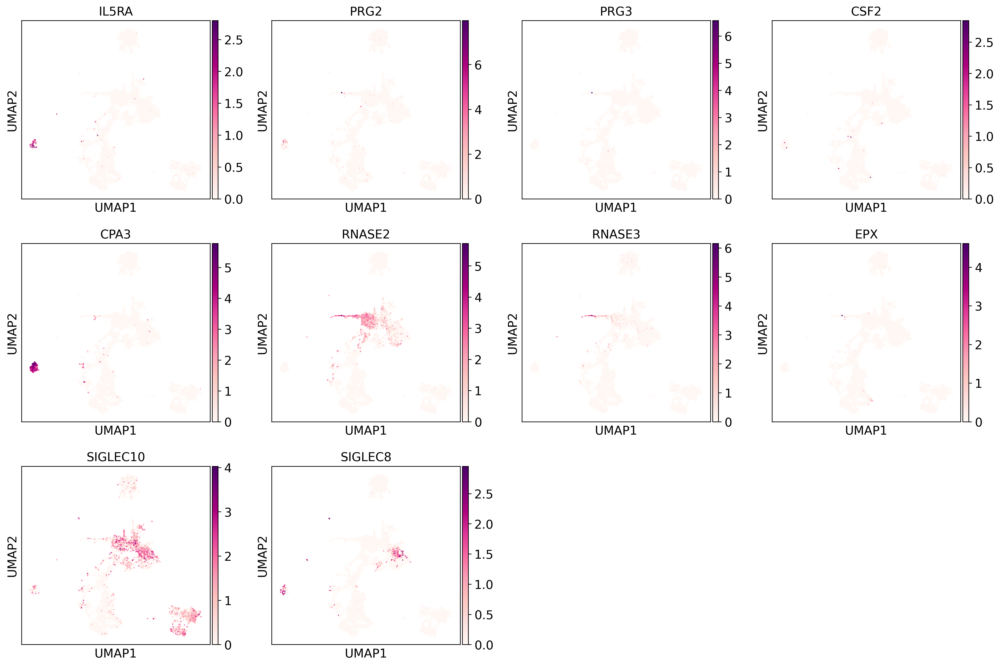

In [77]:
sc.pl.umap(adata, color = ['IL5RA', 'PRG2', 'PRG3', 'CSF2','CPA3', 'RNASE2', 'RNASE3', 'EPX', 'SIGLEC10', 'SIGLEC8'])

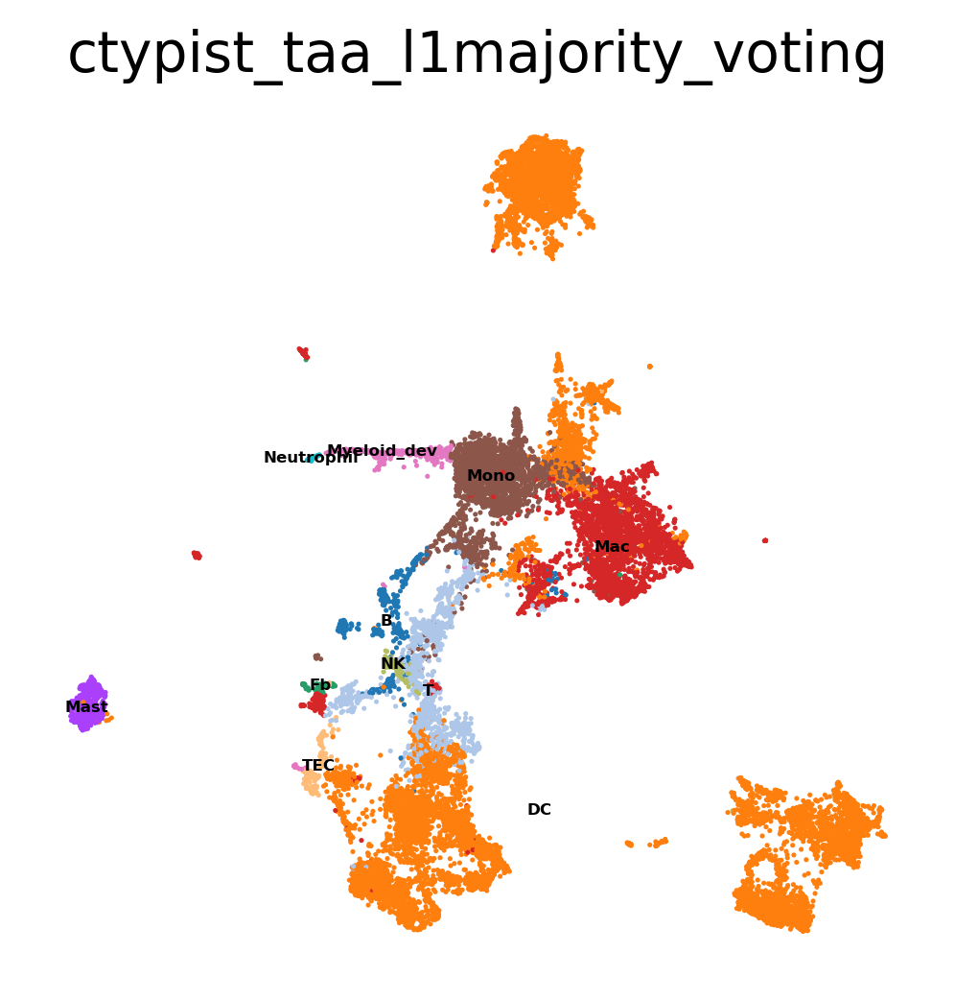

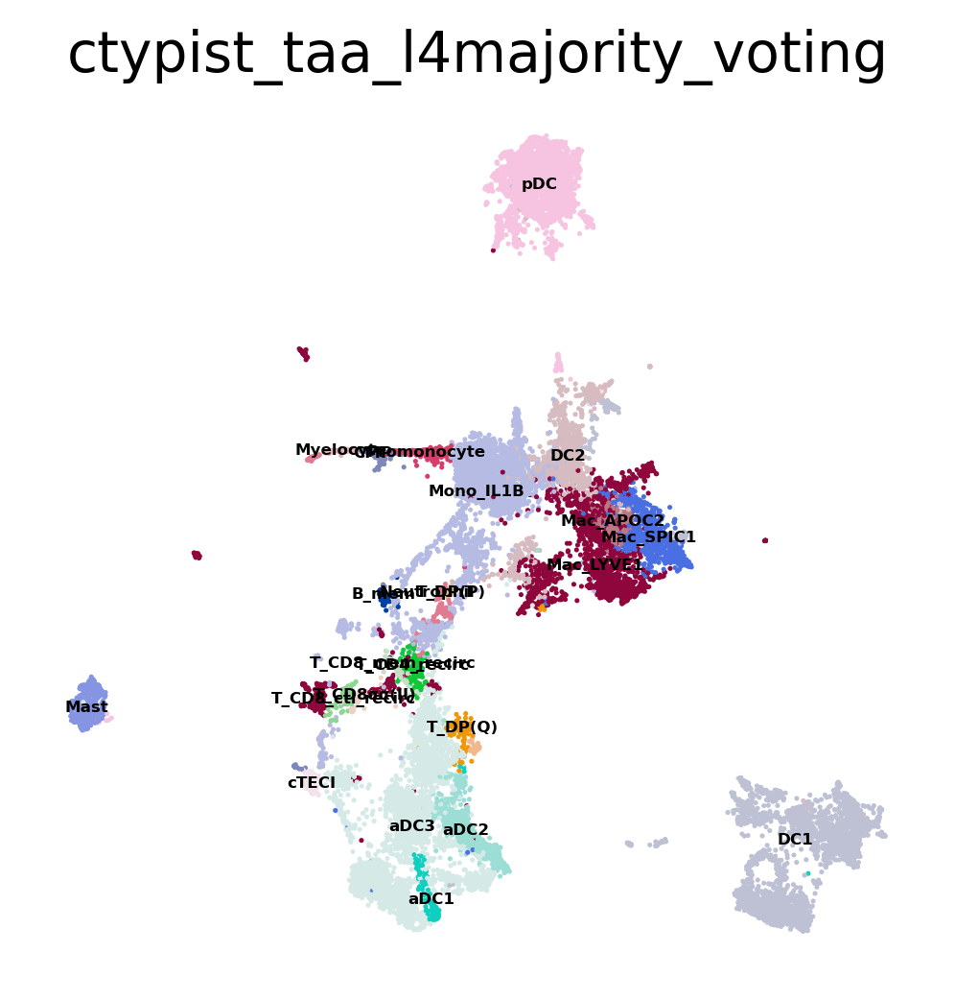

In [20]:
sc.pl.umap(adata, color = ['ctypist_taa_l1majority_voting'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

sc.pl.umap(adata, color = ['ctypist_taa_l4majority_voting'], legend_loc = "on data", legend_fontsize = 4, frameon = False)

In [21]:
def run_leiden(adata, resolutions, key_name,restrict_to = None, legend_loc = "on data", legend_fontsize = 4):
    for r in resolutions:
        if restrict_to:
            sc.tl.leiden(adata, restrict_to = restrict_to, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
        else:
            sc.tl.leiden(adata, resolution = r, key_added = f'{key_name}-leiden_r{str(r)}',
                        flavor="igraph", n_iterations=2)
    sc.pl.umap(adata, color = [f'{key_name}-leiden_r{str(r)}' for r in resolutions] , legend_loc = legend_loc, 
               legend_fontsize = legend_fontsize, frameon = False)


In [22]:
def scvi_markers(vae, cluster, prep_vae = True, adata = None, n_markers=5):
    if prep_vae:
        vae.adata.obs[cluster] = adata.obs.reindex(vae.adata.obs_names)[cluster].copy()
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 1]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)


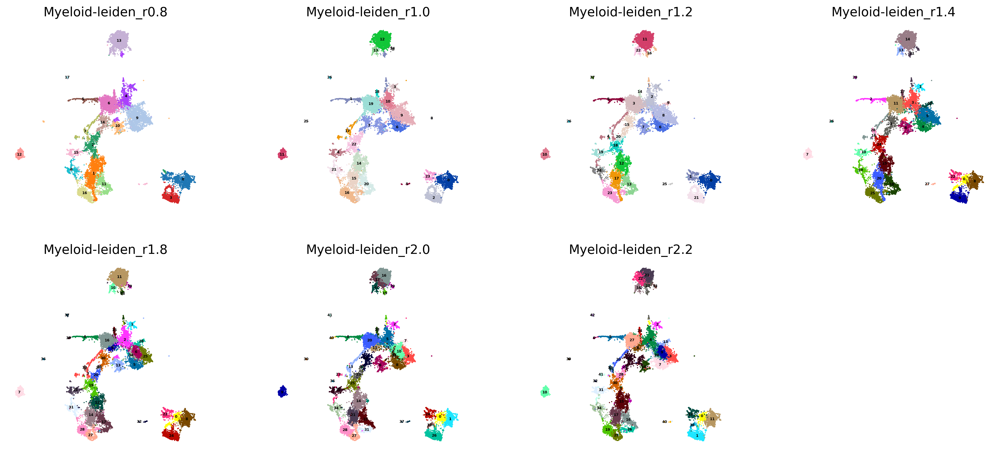

In [23]:
run_leiden(adata, resolutions = [0.8, 1.0, 1.2, 1.4, 1.8, 2.0, 2.2], key_name = 'Myeloid')

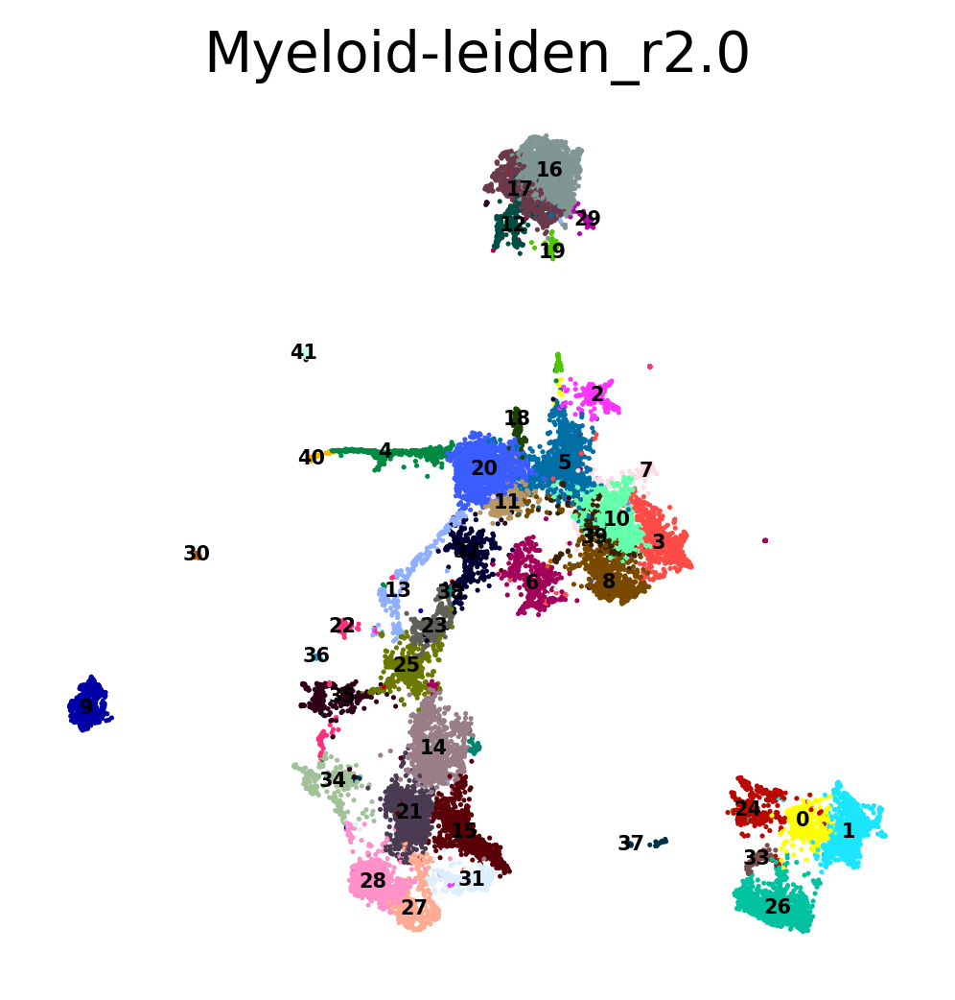

In [39]:
sc.pl.umap(adata, color = 'Myeloid-leiden_r2.0', legend_loc = 'on data', legend_fontsize = 5, frameon = False)

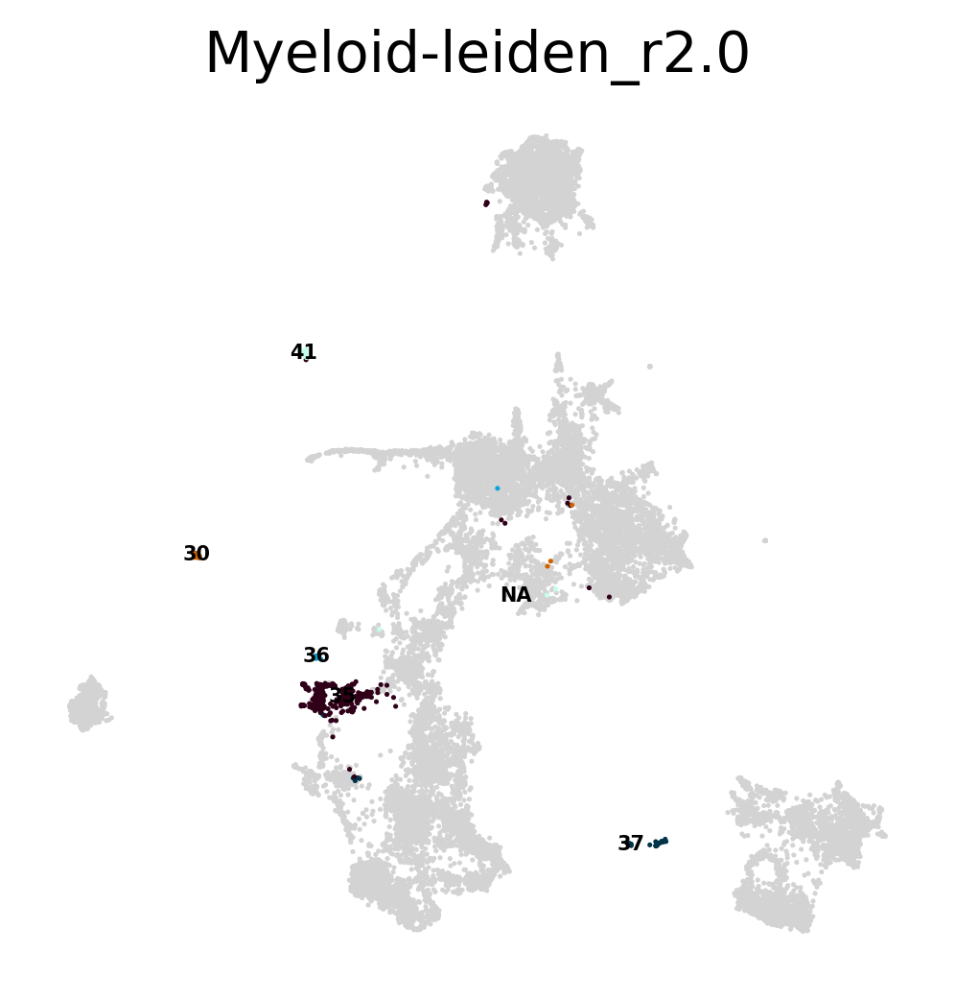

In [87]:
sc.pl.umap(adata, color = 'Myeloid-leiden_r2.0', groups = ['37', '35', '36', '30', '41'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

In [101]:
dblt_mrkrs = ['CD3G', 'CD8A', 'CD8B', 'CD40LG', 'KRT14', 'PDGFRA', 'RGS5', 'CD19', 'PDGFRA', 'CD34',
             'TAGLN', 'LUM', 'VCAM1', 'COL4A1']

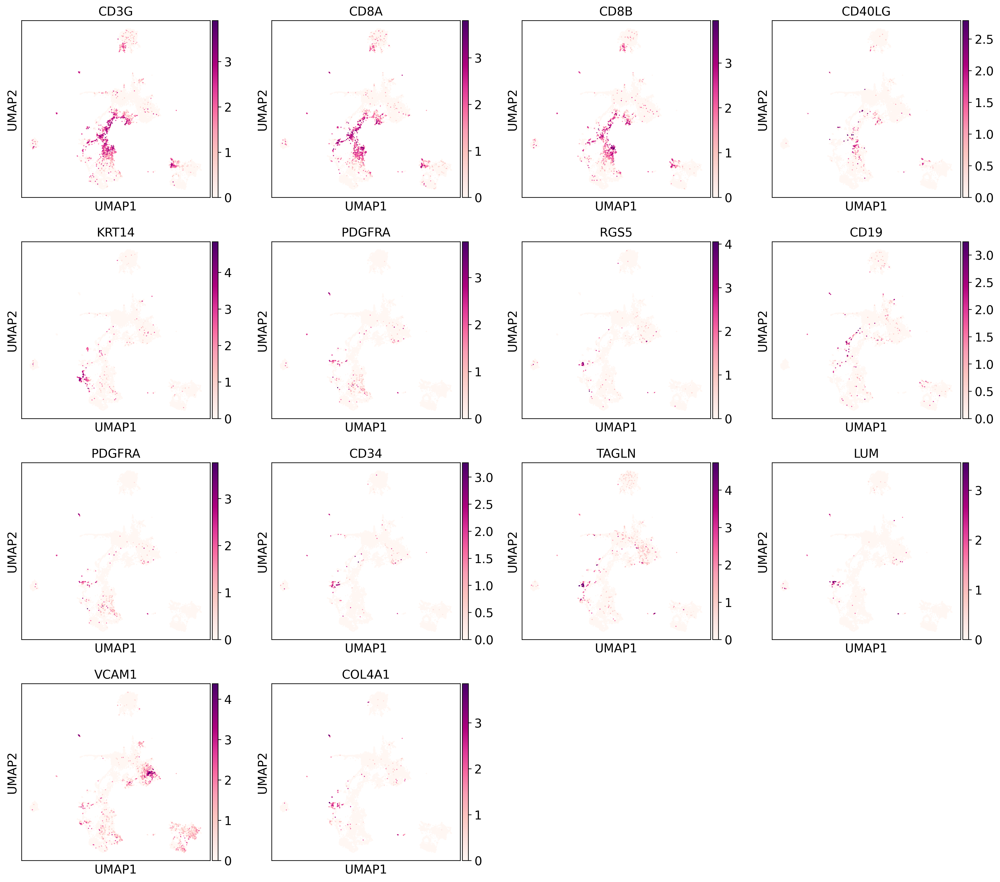

In [102]:
sc.pl.umap(adata, color = dblt_mrkrs)

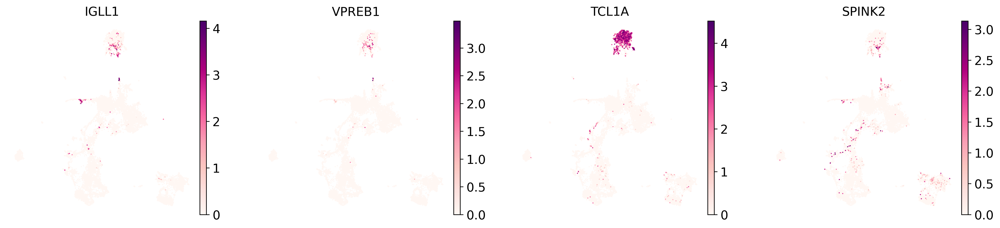

In [51]:
sc.pl.umap(adata, color = ['IGLL1', 'VPREB1', 'TCL1A', 'SPINK2'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

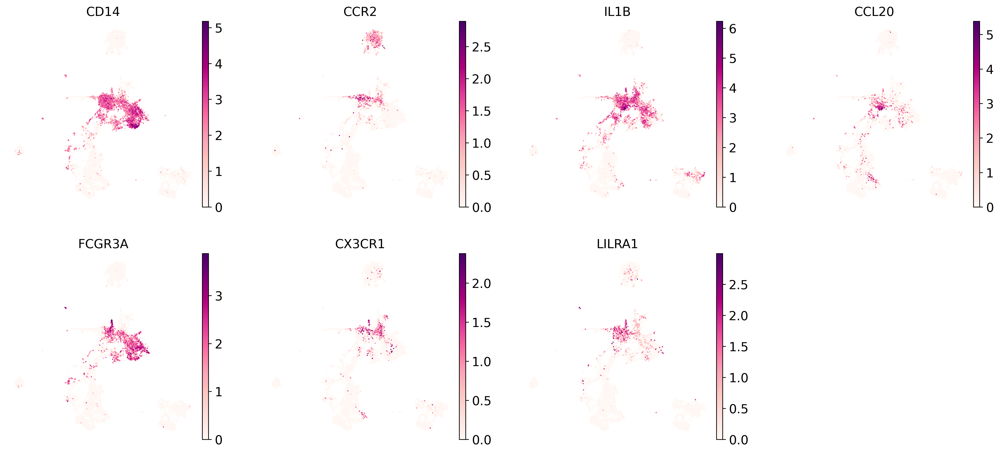

In [79]:
sc.pl.umap(adata, color = ['CD14', 'CCR2', 'IL1B', 'CCL20', 'FCGR3A', 'CX3CR1', 'LILRA1'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

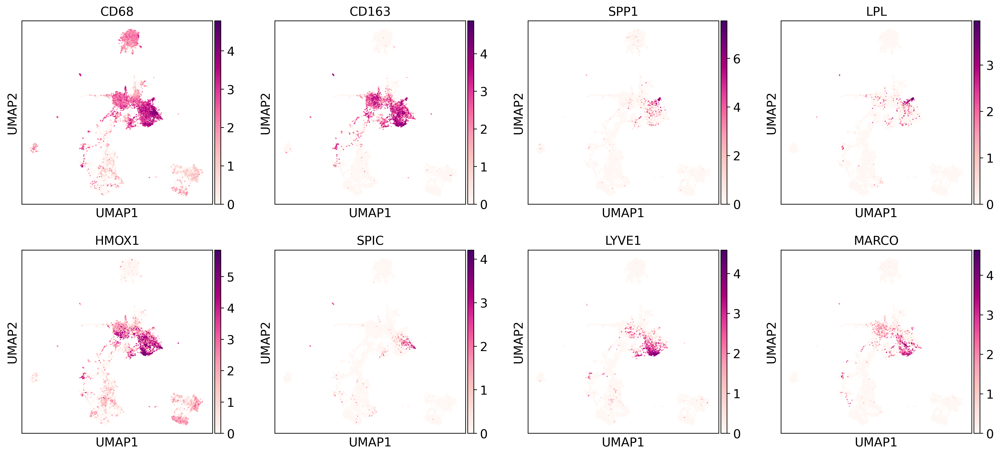

In [99]:
sc.pl.umap(adata, color = ['CD68', 'CD163', 'SPP1', 'LPL', 'HMOX1', 'SPIC', 'LYVE1', 'MARCO'])

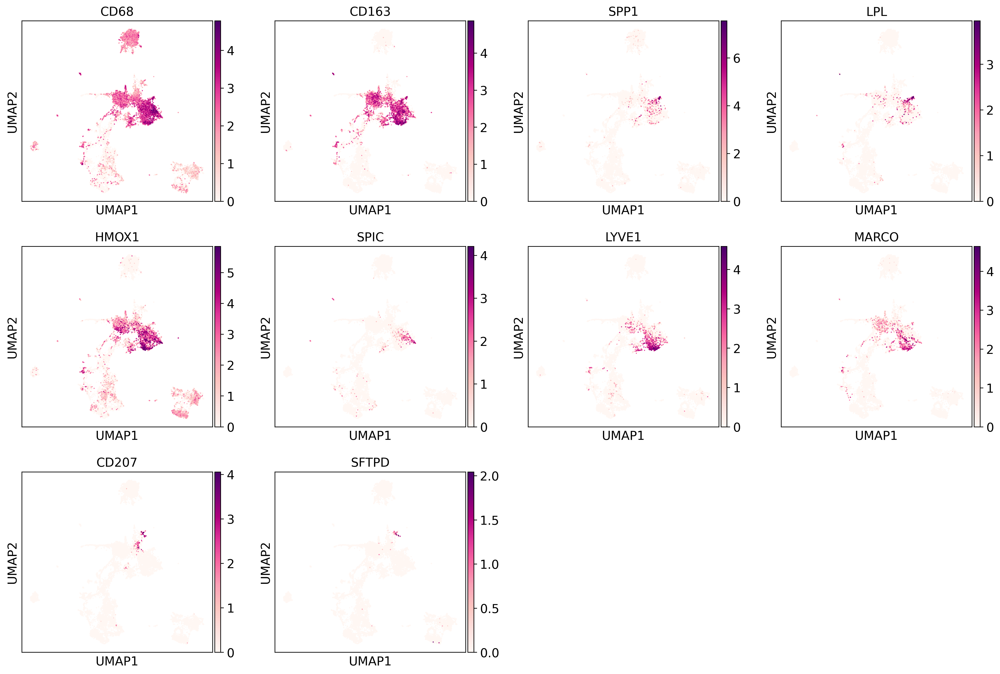

In [100]:
sc.pl.umap(adata, color = ['CD68', 'CD163', 'SPP1', 'LPL', 'HMOX1', 'SPIC', 'LYVE1', 'MARCO', 'CD207', 'SFTPD'])

In [27]:
sc.tl.dendrogram(adata, groupby='Myeloid-leiden_r2.0', use_rep = 'X_scVI')

In [65]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (4,7)

In [ ]:
'Myeloid-T-doublet' if x in ['6', '32', '23', '25', '14'] else
'Myeloid-B-doublet' if x == '13' else
'Myeloid-TEC-doublet' if x in ['22', '34'] else

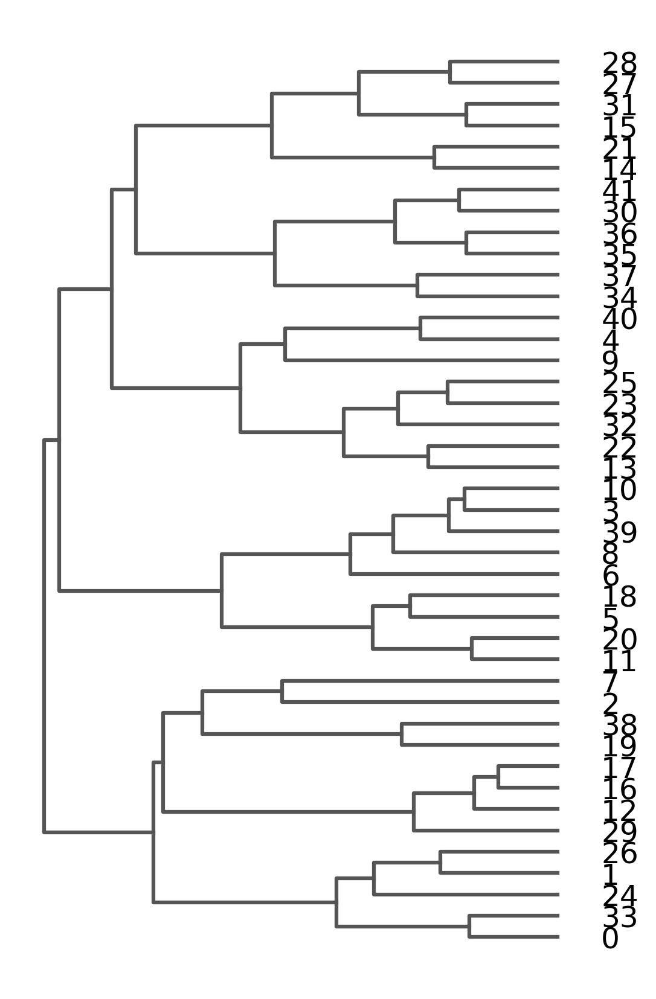

<Axes: >

In [67]:
sc.pl.dendrogram(adata,groupby='Myeloid-leiden_r2.0', orientation = 'left')

In [ ]:
['29', '12', '16', '17', '19']

In [ ]:
'aDC3' if x == '21' else
'aDC2' if x in ['15', '31'] else
'aDC1' if x == '27' else
'28'

categories: 0, 1, 2, etc.
var_group_labels: Early progenitor, Myeloid progenitor, Neutrophil lineage, etc.


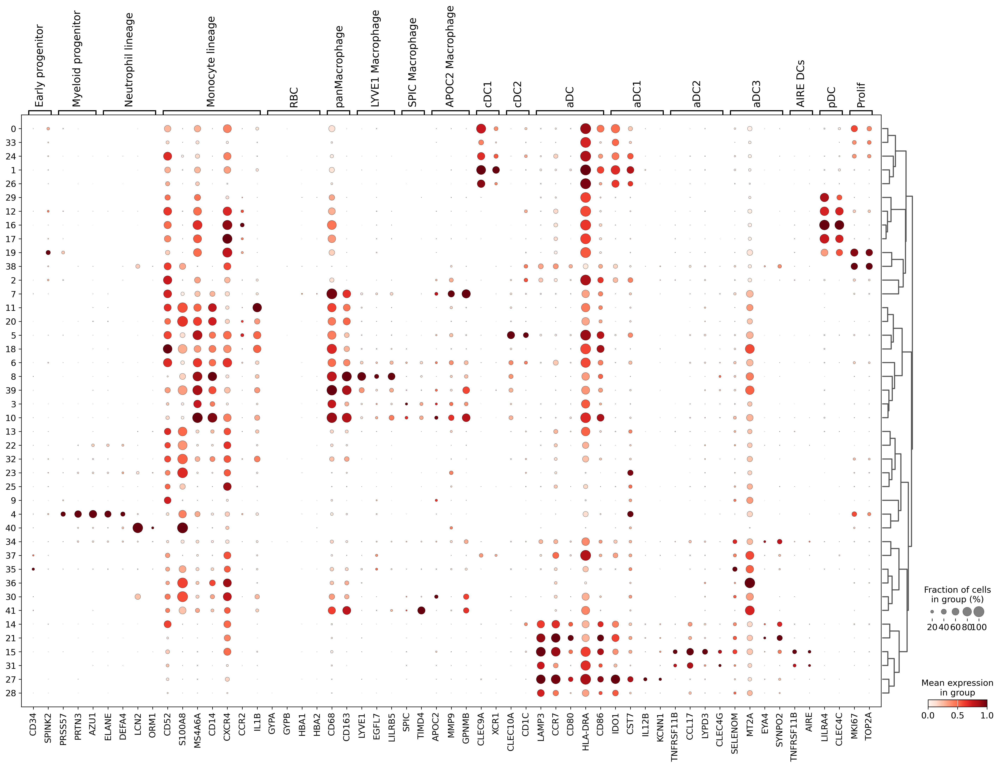

In [31]:
sc.pl.dotplot(adata, groupby = 'Myeloid-leiden_r2.0', var_names = myeloid_mrkrs_dict, dendrogram=True, standard_scale='var')

In [32]:
myeloid_mrkrs = scvi_markers(scvi_run['vae'], cluster = 'Myeloid-leiden_r2.0', prep_vae = True, adata = adata, n_markers=5)

DE...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [04:05<00:00,  5.85s/it]


In [34]:
dp_mrkrs_known = sc.pl.dotplot(adata, var_names = myeloid_mrkrs['markers'], groupby = 'Myeloid-leiden_r2.0', 
                               return_fig = True, standard_scale='var',  dendrogram=True)
dp_mrkrs_known.add_totals()
dp_mrkrs_known.show()

In [42]:
dblt_mrkrs

['CD3G', 'CD8A', 'CD8B', 'CD40LG', 'KRT14', 'PDGFRA', 'RGS5', 'CD19', 'CD20']

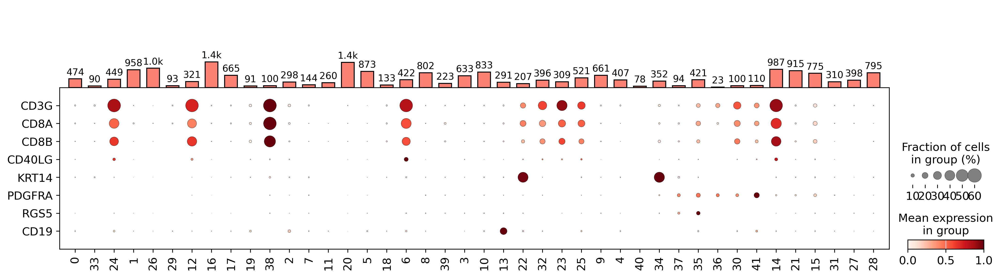

In [46]:
dblt_mrkrs_known = sc.pl.dotplot(adata, var_names = ['CD3G', 'CD8A', 'CD8B', 'CD40LG', 'KRT14', 'PDGFRA', 'RGS5', 'CD19'], groupby = 'Myeloid-leiden_r2.0', 
                               return_fig = True, standard_scale='var',  dendrogram=True, swap_axes=True)
dblt_mrkrs_known.add_totals()
dblt_mrkrs_known.show()

## Annotate cells

In [103]:
adata.obs['Myeloid_anno'] = adata.obs['Myeloid-leiden_r2.0'].apply(lambda x:'DC1-XCRhi' if x == '1' else
'DC1-XCRlo' if x == '26' else
'DC1-prolif' if x in ['0', '33'] else
'DC1-T-doublet' if x == '24' else
'pDC-doublet' if x == '12' else
'pDC' if x in ['29', '16', '17', '19'] else
'Mono-doublet' if x == '38' else
'DC_CD207' if x == '2' else 
'Mono' if x in ['20', '11', '18'] else
'DC2' if x == '5' else
'Mac_SPIC' if x == '3' else
'Mac_SPP1' if x == '7' else
'Mac_LYVE1' if x == '8' else
'Mac' if x in ['39', '10'] else
'Myeloid-T-doublet' if x in ['6', '32', '23', '25', '14', '35', '36', '30', '41'] else
'Myeloid-B-doublet' if x == '13' else
'Myeloid-TEC-doublet' if x in ['22', '34'] else
'Mast' if x == '9' else
'Neutrophil_dev' if x == '4' else
'Neutrophil_mat' if x == '40' else
'FB-doublet' if x == '37' else
'aDC3' if x == '21' else
'aDC2' if x in ['15', '31'] else
'aDC1' if x == '27' else
'aDC' if x == '28' else 'unknown')



In [ ]:
adata.obs.to_csv()

In [106]:
doublets = [i for i in adata.obs['Myeloid_anno'].cat.categories if 'doublet' in i]

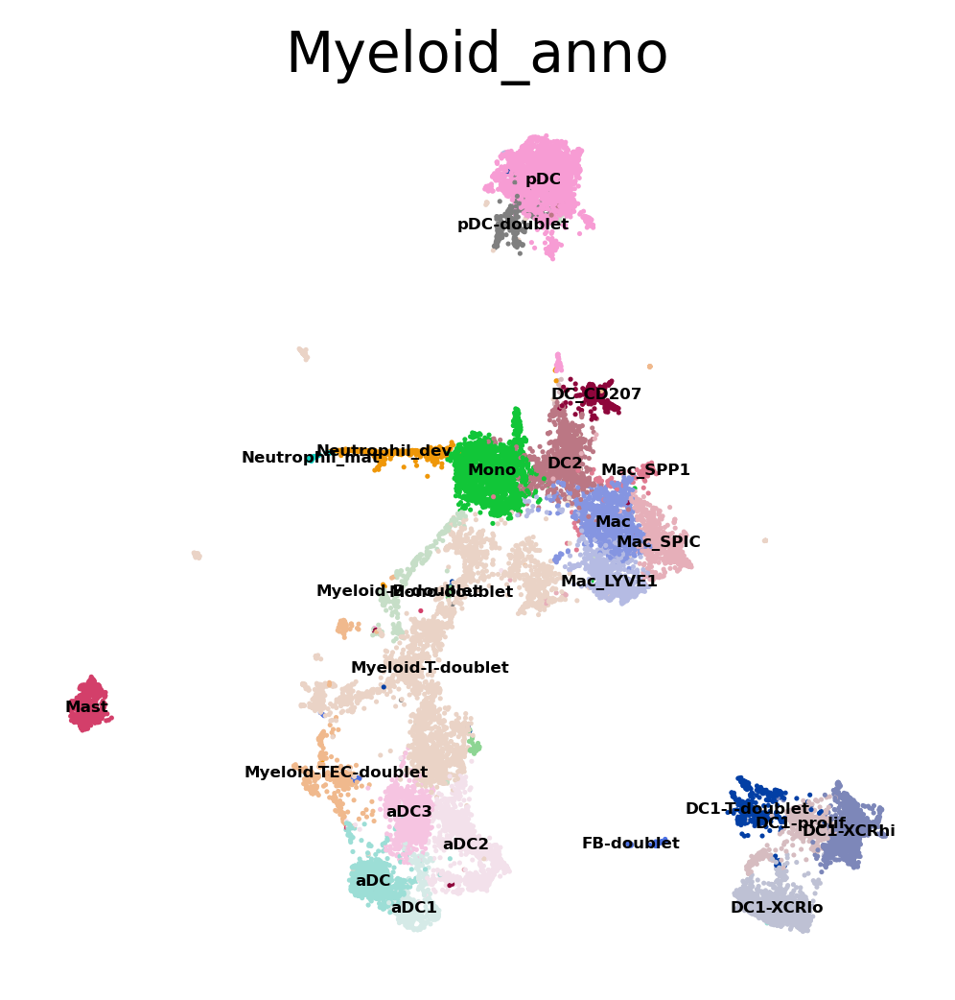

In [105]:
sc.pl.umap(adata, color = 'Myeloid_anno', frameon = False, legend_loc = 'on data', legend_fontsize = 4)

In [107]:
adata_dbrm = adata[~adata.obs['Myeloid_anno'].isin(doublets),]

In [108]:
adata.shape
adata_dbrm.shape

(19821, 35530)

(14718, 35530)

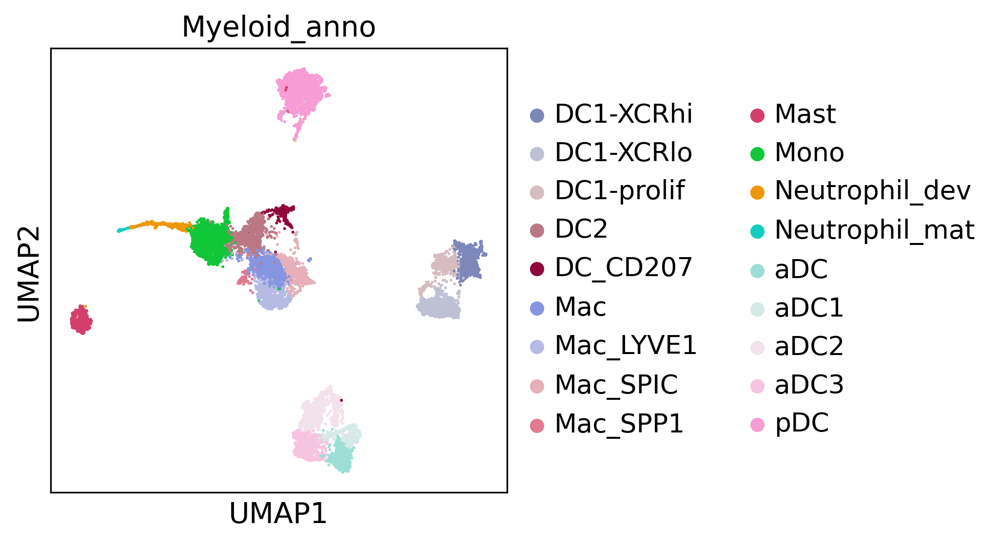

(AnnData object with n_obs × n_vars = 14718 × 35530
     obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l1conf_score', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_score', 'Myelo

In [111]:
regen_embed(adata_dbrm,'Myeloid_anno'), 

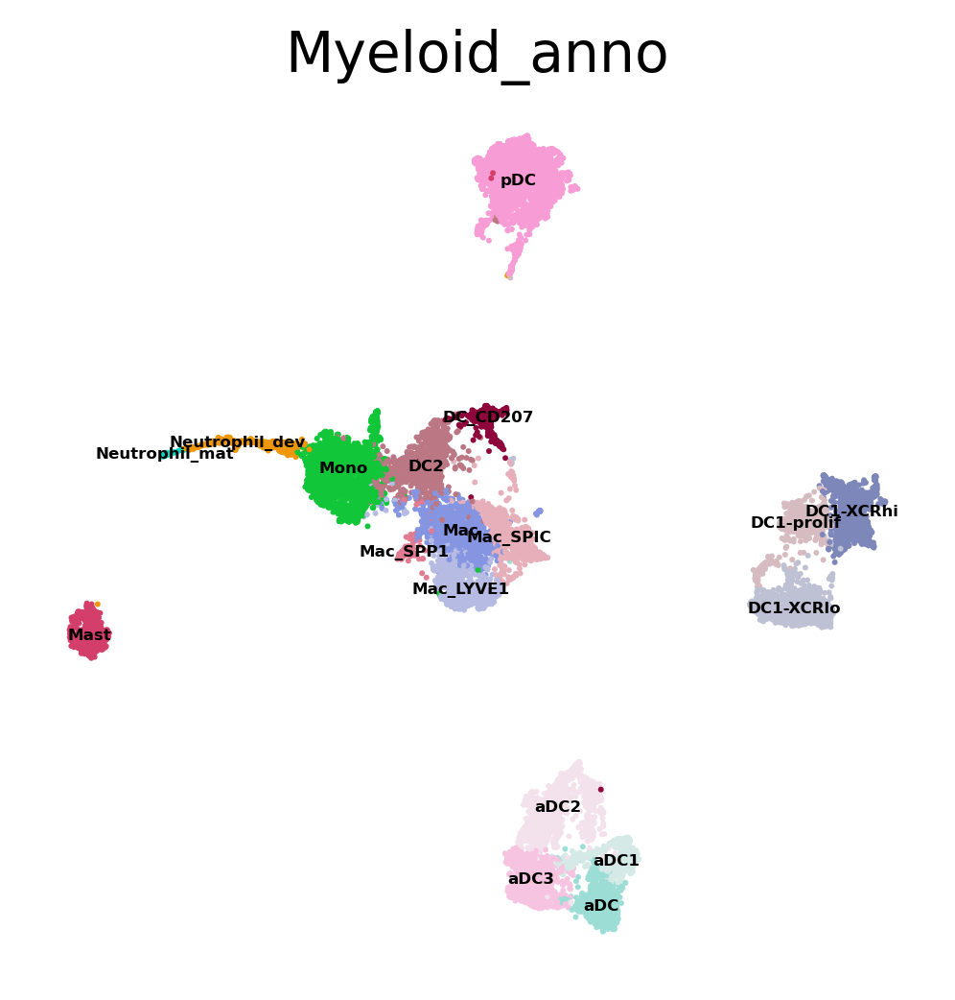

In [112]:
sc.pl.umap(adata_dbrm, color = 'Myeloid_anno', frameon = False, legend_loc = 'on data', legend_fontsize = 4)

In [113]:
pd.crosstab(adata_dbrm.obs['Myeloid_anno'], adata_dbrm.obs['donor'])

donor,A16,A43,A45,A51,A53,A56,A66,A67,A70,A72,A74,D1,D2,D3,D4,D5,NIHTHY0057,NIHTHY0081,NIHTHY0093,NIHTHY0096,NIHTHY0101,NIHTHY0112,P1,P2,P3,T03,T06,T07,TSC-CT8,TSC-CT9,TSC-CT10,TSC-CT12,TSC-CT13,TSP2,TSP14,Thy5,Thy6,Thy7,Thy8,Thy9,Thy10,Thy11,Thy12,Thy13,Thy14,Thy15,Thy16,U09,U40,U48,Z11,Z12,Z13,Z15,Z16,Z17,Z19,baut_adult1,baut_paed1,baut_paed2
Myeloid_anno,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
DC1-XCRhi,34,13,36,6,69,137,7,24,2,8,12,50,50,87,36,45,0,0,0,0,8,17,1,2,19,10,30,43,0,1,0,0,0,7,2,15,1,0,1,1,2,0,1,0,2,16,2,3,14,76,19,15,14,7,4,2,7,0,0,0
DC1-XCRlo,30,4,11,2,6,1,15,5,4,0,1,130,115,188,63,223,0,0,2,0,8,6,8,4,12,3,2,3,12,17,6,86,5,2,0,0,0,2,0,0,2,0,4,4,2,1,4,0,2,16,2,10,8,3,1,7,4,1,1,0
DC1-prolif,11,8,14,4,15,3,12,11,9,3,9,33,32,54,14,42,0,0,0,1,19,41,1,5,34,11,33,14,0,0,2,2,0,3,1,12,0,1,3,5,2,0,0,1,2,8,1,1,3,37,4,7,15,2,9,7,3,0,0,0
DC2,64,27,32,18,45,4,15,40,18,9,51,27,54,77,27,60,0,0,5,0,13,12,11,6,9,1,26,22,3,1,1,1,2,19,6,15,0,3,6,2,1,4,3,4,5,32,4,3,9,23,6,8,8,4,2,16,9,0,0,0
DC_CD207,12,7,29,3,14,23,8,6,10,2,5,5,6,18,8,16,1,0,6,0,14,6,2,3,2,2,5,14,0,0,0,0,0,3,1,0,0,1,0,1,1,0,1,9,1,5,0,4,2,12,1,4,8,4,5,6,2,0,0,0
Mac,21,11,126,14,133,0,15,112,37,4,185,16,18,17,10,16,0,0,11,1,14,11,0,0,0,2,3,33,0,0,0,0,0,46,85,3,0,1,5,2,1,2,3,0,7,11,4,0,4,39,3,7,7,1,4,9,2,0,0,0
Mac_LYVE1,9,13,21,36,99,17,12,71,66,2,159,1,1,0,0,0,0,0,1,0,1,2,0,0,1,1,0,3,0,0,0,0,0,37,115,0,0,0,2,0,1,0,0,0,6,96,7,0,1,6,0,2,7,1,1,4,0,0,0,0
Mac_SPIC,15,7,38,4,25,3,53,43,22,1,36,21,34,42,12,63,0,0,7,0,5,5,0,0,1,7,7,14,0,0,0,0,0,5,56,3,6,1,2,2,0,2,2,1,2,8,19,1,2,27,1,5,5,4,3,8,1,0,1,1
Mac_SPP1,3,0,0,1,6,0,0,8,6,0,9,1,0,1,1,4,0,0,0,0,3,0,0,0,0,1,0,3,0,0,0,0,0,40,46,0,0,1,0,1,0,0,0,0,0,1,0,0,0,3,0,0,0,1,1,3,0,0,0,0


In [126]:
scvi_obj_version

'v2_2layers_300epochs_2025-01-16'

In [127]:
adata.obs.to_csv(f'{data_path}/objects/thyAgeing_Myeloid_{scvi_obj_version}_anno1.csv')

In [120]:
sc.tl.dendrogram(adata_dbrm, groupby = 'Myeloid_anno', use_rep = 'X_scVI')

categories: DC1-XCRhi, DC1-XCRlo, DC1-prolif, etc.
var_group_labels: Early progenitor, Myeloid progenitor, Neutrophil lineage, etc.


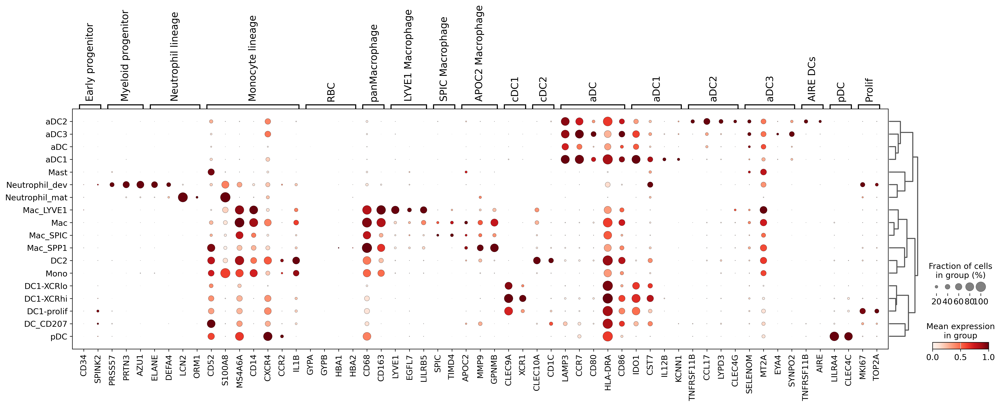

In [122]:
sc.pl.dotplot(adata_dbrm, groupby = 'Myeloid_anno', var_names = myeloid_mrkrs_dict, 
              dendrogram=True, standard_scale='var')

In [130]:
obs = pd.read_csv(f'{data_path}/objects/thyAgeing_Myeloid_{scvi_obj_version}_anno1.csv', index_col = 0)